# Extract Mechanisms from Space

## Setup Environment

In [1]:
import os
import numpy as np
import pandas as pd

import scanpy as sc
import liana as li

In [2]:
import sys
sys.path.append(os.path.join('..', 'spot_calling'))

In [3]:
from utils import load_prep_slide

In [4]:
data_dir = os.path.join('..', '..', 'data', 'heart_visium')

In [5]:
dataset_names = [f for f in os.listdir(data_dir) if f.endswith('.h5ad')]

In [152]:
metadata = pd.read_csv("../spot_calling/visium_meta.csv")

## Process Datasets

In [153]:
lrdatas = {}

In [154]:
for dataset_name in dataset_names:
    print(f"dataset_name: {dataset_name}")
    adata = load_prep_slide(data_dir, dataset_name, add_sample_name=True, min_genes = 200)

    li.mt.lr_bivar(adata,
                    function_name='cosine',
                    expr_prop=0.1,
                    pvalue_method=None,
                    use_raw=False,
                    )
    lrdata = li.fun.obsm_to_adata(adata, 'local_scores')
    
    # shape
    print(f"lrdata shape: {lrdata.shape}")

    lrdatas[dataset_name] = lrdata


dataset_name: AKK001_157785.h5ad


KeyboardInterrupt: 

## Run NMF on the whole Dataset

In [ ]:
from sklearn.decomposition import NMF
from matplotlib import pyplot as plt

In [ ]:
features = pd.concat([lrdatas[dataset_name].var for dataset_name in lrdatas])
features['count'] = 1 
features = features.reset_index().groupby('interaction').sum().sort_values('count')

<AxesSubplot:>

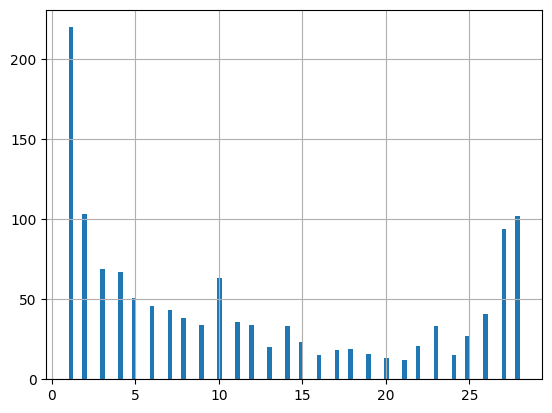

In [ ]:
features['count'].hist(bins=100)

Keep features in at least 10 samples (~1/3rds of the datasets)

In [ ]:
features = features[features['count'] >= 10]

In [ ]:
features.index

Index(['PLAU&PLAUR', 'CCN2&EGFR', 'TGFB1&TGFBR1_TGFBR2', 'PGF&NRP2',
       'COL4A2&ITGA3_ITGB1', 'ST6GAL1&EGFR', 'LAMA2&ITGA3_ITGB1',
       'CXCL12&CXCR4', 'LAMA4&ITGA3_ITGB1', 'MIF&EGFR',
       ...
       'PSAP&LRP1', 'COL4A2&CD93', 'COL1A2&CD93', 'TGM2&ITGB1', 'COL1A2&CD36',
       'COL1A1&ITGA5', 'COL1A1&CD93', 'COL1A1&CD36', 'COL4A1&CD93',
       'A2M&LRP1'],
      dtype='object', name='interaction', length=635)

In [ ]:
lrdata_all = sc.concat(lrdatas, join='outer', fill_value=0)

In [ ]:
lrdata_all

AnnData object with n_obs × n_vars = 91517 × 1306
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'celltype_niche', 'molecular_niche', 'n_genes'
    obsm: 'compositions', 'mt', 'spatial', 'local_scores'

In [ ]:
# subset to features found in at least 10 datasets
lrdata_all = lrdata_all[:, features.index]

In [ ]:
lrdata_all

View of AnnData object with n_obs × n_vars = 91517 × 635
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'celltype_niche', 'molecular_niche', 'n_genes'
    obsm: 'compositions', 'mt', 'spatial', 'local_scores'

UMAP + Leiden

In [ ]:
# lrdata_all.layers['cosine'] = lrdata_all.X.copy()
# sc.pp.scale(lrdata_all, max_value=10)
# sc.tl.pca(lrdata_all, n_comps=30)
# sc.pl.pca_variance_ratio(lrdata_all, log=True)
# sc.pp.neighbors(lrdata_all, n_neighbors=10, n_pcs=20)
# sc.tl.leiden(lrdata_all, resolution=0.5)
# sc.tl.umap(lrdata_all)
# sc.pl.umap(lrdata_all, color=['leiden', 'molecular_niche', 'batch', 'patient', 'patient_group'], ncols=2)

### Estimate Optimal Factor N

In [ ]:
X = lrdata_all.X
# from sklearn.preprocessing import MinMaxScaler
# scaler = MinMaxScaler()
# X = scaler.fit_transform(lrdata_all.X)

In [ ]:
def calculate_reconstruction_error(X, n):
    model = NMF(n_components=n, random_state=0, max_iter=200)  # Create NMF model
    W = model.fit_transform(X)  # Compute NMF decomposition
    H = model.components_
    Xhat = np.dot(W, H)
    error = np.mean(np.sqrt((X - Xhat) ** 2))  # Reconstruction error
    return error


In [ ]:
n_values = range(1, 15)

In [ ]:
errors = []
for n in n_values:
    error = calculate_reconstruction_error(X, n)  # X is your input data
    errors.append(error)


/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 500 reached. Increase it to improve convergence.
/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 500 reached. Increase it to improve convergence.
/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 500 reached. Increase it to improve convergence.
/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 500 reached. Increase it to improve convergence.


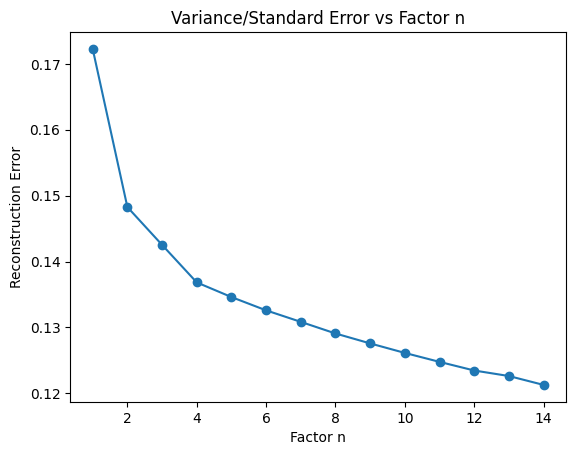

In [ ]:
plt.plot(n_values, errors, marker='o')
plt.xlabel('Factor n')
plt.ylabel('Reconstruction Error')
plt.title('Variance/Standard Error vs Factor n')
plt.show()

In [ ]:
lrdata_all

View of AnnData object with n_obs × n_vars = 91517 × 635
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'celltype_niche', 'molecular_niche', 'n_genes', 'leiden', 'slide_name', 'patient', 'patient_region_id', 'patient_group', 'major_labl', 'batch', 'hca_sample_id'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors', 'molecular_niche_colors', 'batch_colors', 'patient_colors', 'patient_group_colors'
    obsm: 'compositions', 'mt', 'spatial', 'local_scores', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'cosine'
    obsp: 'distances', 'connectivities'

### NMF

In [ ]:
# Create an instance of the NMF class
model = NMF(n_components=4, init='random', random_state=0)

In [ ]:
# Fit the model to the data and obtain the factorized matrices
W = model.fit_transform(lrdata_all.X)
H = model.components_

/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.


In [ ]:
 ## NOTE take index from adata.obs.index, not from the obsm matrix
columns = [f"Factor{i+1}" for i in range(W.shape[1])]

In [ ]:
lrdata_all.obsm['NMF_W'] = pd.DataFrame(W, index=lrdata_all.obs.index, columns=columns)
lrdata_all.varm['NMF_H'] = H.T # NOTE I don't convert to dataframe, because it does not get filtered

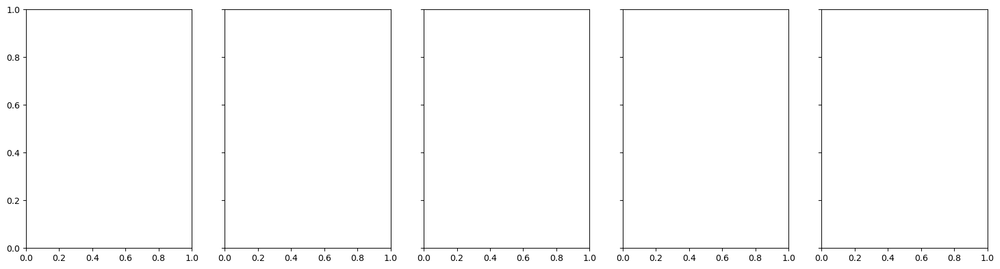

In [ ]:
fig, ax = plt.subplots(1,5, figsize=(20, 5), sharex=True, sharey=True)

In [ ]:
adatas = {}

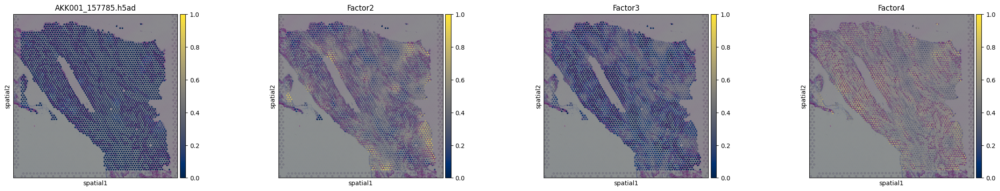

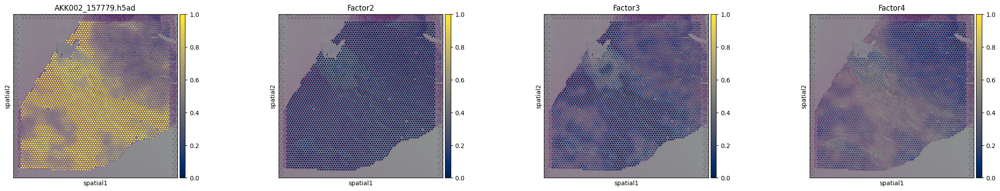

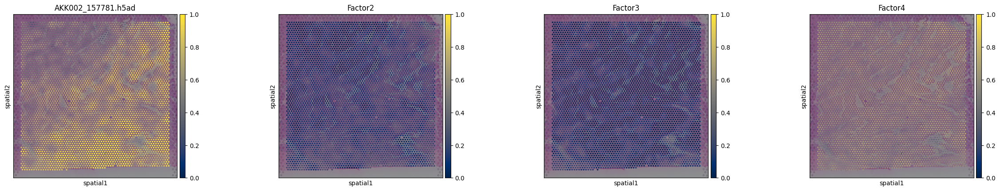

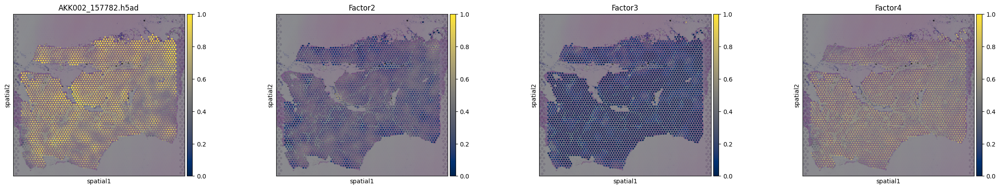

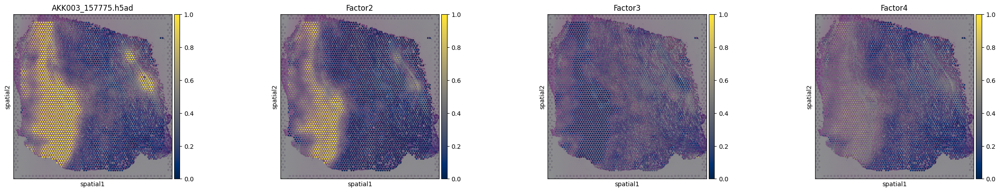

...

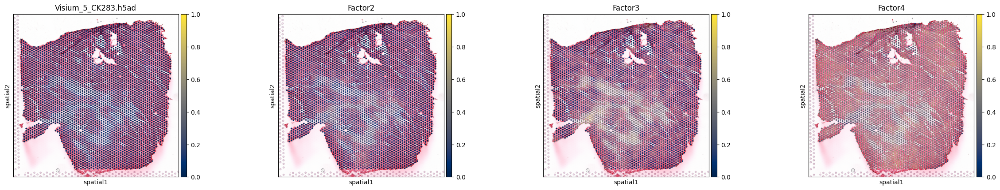

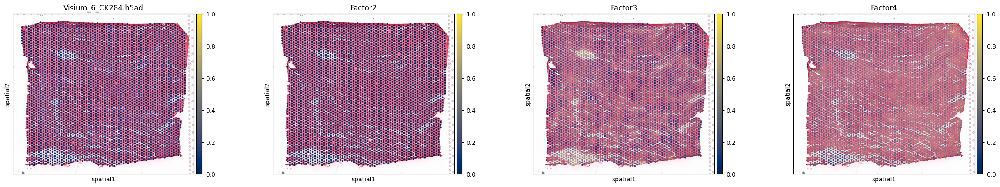

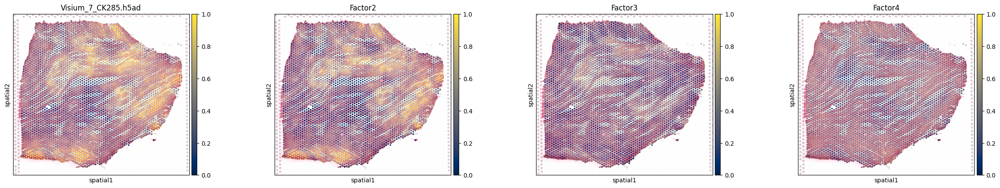

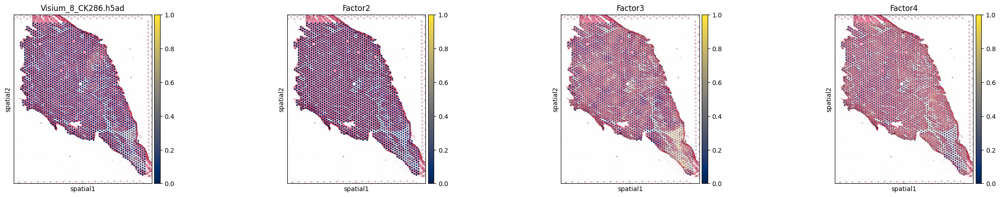

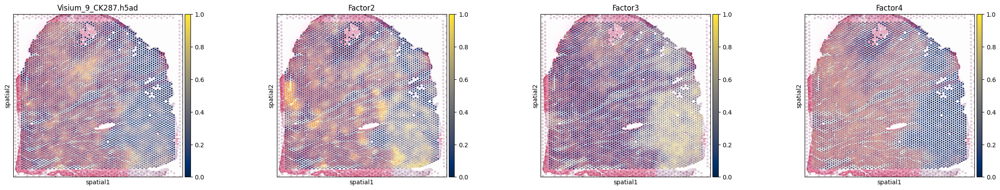

In [ ]:
n = 0
# transfer the NMF factors to the individual samples
for sample in lrdatas:
    # each
    lrdata = lrdatas[sample]
    
    # Get the NMF factors for the current sample from the full dataset
    temp = lrdata_all[lrdata_all.obs.index.isin(lrdata.obs.index), :]
    temp = temp[:, temp.var.index.isin(lrdata.var.index)]
    
    # extract from obsm
    ## TODO need to figure out how to handle .obsm & .uns - they keep getting copied over
    ad_nmf = li.fun.obsm_to_adata(temp, obsm_key='NMF_W', _uns=lrdata.uns)
    
    # plot
    sc.pl.spatial(ad_nmf, color=temp.obsm['NMF_W'].columns, cmap='cividis', title=sample, vmax=1, vmin=0) # 
    
    # save to MuData
    adatas[sample] = ad_nmf
    n=n+1

In [ ]:
fig.clear()

In [ ]:
W.shape

(91517, 4)

In [ ]:
nmfdata = li.fun.obsm_to_adata(lrdata_all, 'NMF_W')

In [ ]:
nmfdata.X[nmfdata.X <= 0.1] = 0

In [155]:
indices = lrdata_all.obs.index
nmfdata.obs = nmfdata.obs.merge(metadata, left_on='sample', right_on='slide_name')
nmfdata.obs.index = indices

/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer



In [157]:
nmfdata.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,...,celltype_niche,molecular_niche,n_genes,slide_name,patient,patient_region_id,patient_group,major_labl,batch,hca_sample_id
AKK001_157785-AAACAAGTATCTCCCA-1,1,50,102,AKK001_157785,1811,7.502186,3849.0,8.255829,28.474929,36.451026,...,ctniche_1,molniche_4,1811,AKK001_157785,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785-AAACAGAGCGACTCCT-1,1,14,94,AKK001_157785,1701,7.439559,2955.0,7.991592,21.421320,29.238579,...,ctniche_3,molniche_3,1701,AKK001_157785,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785-AAACATTTCCCGGATT-1,1,61,97,AKK001_157785,1755,7.470794,3352.0,8.117611,25.178998,33.621718,...,ctniche_8,molniche_1,1755,AKK001_157785,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785-AAACCGGGTAGGTACC-1,1,42,28,AKK001_157785,1929,7.565275,3789.0,8.240121,23.621008,32.092901,...,ctniche_6,molniche_1,1929,AKK001_157785,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785-AAACCGTTCGTCCAGG-1,1,52,42,AKK001_157785,1756,7.471363,3920.0,8.274102,31.530612,40.331633,...,ctniche_7,molniche_4,1756,AKK001_157785,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Visium_9_CK287-TTGTTTCACATCCAGG-1,1,58,42,Visium_9_CK287,1201,7.091742,1912.0,7.556428,25.523013,33.943515,...,ctniche_4,molniche_9,1201,Visium_9_CK287,P9,GT/IZ_P9,group_2,IZ,ACH,ACH0012
Visium_9_CK287-TTGTTTCATTAGTCTA-1,1,60,30,Visium_9_CK287,2255,7.721349,3960.0,8.284252,19.621212,26.742424,...,ctniche_4,molniche_11,2255,Visium_9_CK287,P9,GT/IZ_P9,group_2,IZ,ACH,ACH0012
Visium_9_CK287-TTGTTTCCATACAACT-1,1,45,27,Visium_9_CK287,1135,7.035269,1660.0,7.415175,20.662651,29.578313,...,ctniche_6,molniche_1,1135,Visium_9_CK287,P9,GT/IZ_P9,group_2,IZ,ACH,ACH0012
Visium_9_CK287-TTGTTTGTATTACACG-1,1,73,41,Visium_9_CK287,1373,7.225481,2219.0,7.705263,27.219468,34.610185,...,ctniche_4,molniche_9,1373,Visium_9_CK287,P9,GT/IZ_P9,group_2,IZ,ACH,ACH0012


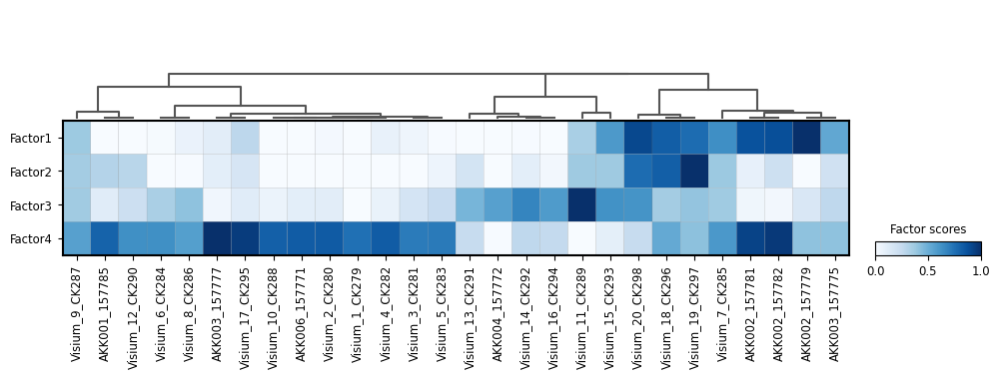

In [189]:
sc.pl.matrixplot(nmfdata, var_names=nmfdata.var.index, groupby='sample', standard_scale='var', dendrogram=True, cmap='Blues', swap_axes=True, colorbar_title='Factor scores')

In [229]:
import decoupler as dc

In [404]:
nmfbulk = dc.get_pseudobulk(nmfdata, sample_col='sample', groups_col=None, mode='mean', skip_checks=True, min_cells=0, min_counts=0)

In [405]:
nmf_df = pd.DataFrame(nmfbulk.X, index=nmfbulk.obs.index, columns=nmfbulk.var.index)

In [407]:
nmf_df.to_csv('nmf_df.csv')

In [243]:
# factors to long format
nmf_df = nmf_df.reset_index().melt(id_vars='index', var_name='factor', value_name='score')

In [245]:
nmf_df.set_index('index', inplace=True)

In [223]:
metadata.set_index("slide_name", inplace=True)

In [246]:
nmf_df = nmf_df.merge(metadata, left_index=True, right_index=True)

In [247]:
nmf_df

,factor,score,patient,patient_region_id,patient_group,major_labl,batch,hca_sample_id
AKK001_157785,Factor1,0.000519,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785,Factor2,0.363184,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785,Factor3,0.094180,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785,Factor4,0.536012,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK002_157779,Factor1,0.852535,P3,IZ_P3,group_2,IZ,10X,10X0017
...,...,...,...,...,...,...,...,...
Visium_8_CK286,Factor4,0.379673,P11,RZ_P11,group_1,RZ,ACH,ACH0019
Visium_9_CK287,Factor1,0.320255,P9,GT/IZ_P9,group_2,IZ,ACH,ACH0012
Visium_9_CK287,Factor2,0.422943,P9,GT/IZ_P9,group_2,IZ,ACH,ACH0012
Visium_9_CK287,Factor3,0.295062,P9,GT/IZ_P9,group_2,IZ,ACH,ACH0012


In [248]:
import plotnine as p9

In [249]:
nmf_df.head()

,factor,score,patient,patient_region_id,patient_group,major_labl,batch,hca_sample_id
AKK001_157785,Factor1,0.000519,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785,Factor2,0.363184,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785,Factor3,0.094180,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK001_157785,Factor4,0.536012,P5,RZ/FZ_P5,group_1,FZ,10X,10X0027
AKK002_157779,Factor1,0.852535,P3,IZ_P3,group_2,IZ,10X,10X0017


In [300]:
## geomtile plot
plot = (
    p9.ggplot(nmf_df, p9.aes(x='hca_sample_id', y='factor', fill='score'))
    + p9.geom_tile()
    + p9.scale_fill_cmap('Blues')
    + p9.labs(x='Sample', y='Factor', fill='Score')
    + p9.theme_bw(base_size=16)
    + p9.theme(figure_size=(10, 4))
    + p9.theme(axis_text_x=p9.element_text(rotation=90, hjust=0.5))
    
)

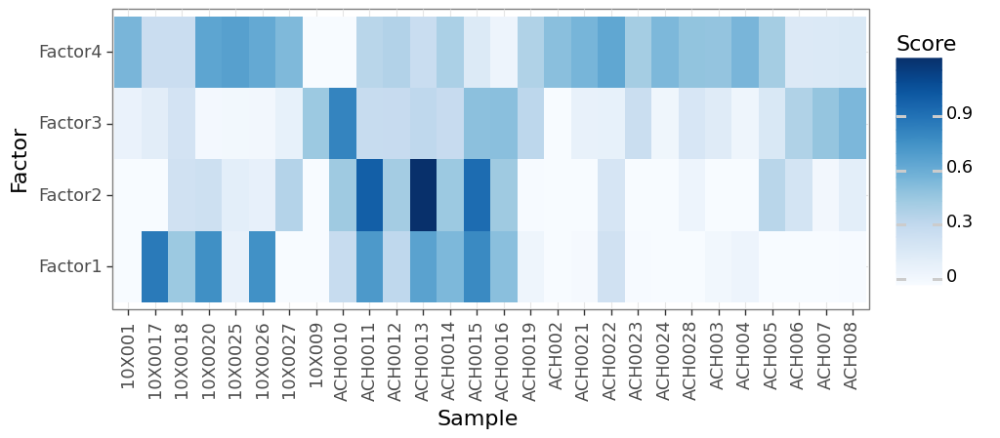

<ggplot: (8743761112233)>

In [301]:
plot

In [320]:
import seaborn as sns

In [328]:
group_annotations = nmfbulk.obs['patient_group'].values
group_labels = nmfbulk.obs['sample'].values

In [339]:
# import colour map Dark2 from seaborn
cmap = sns.color_palette('Dark2', n_colors=len(set(group_annotations)))

In [363]:
# get cmap values for each group annotation as hex
group_cmap = dict(zip(set(group_annotations), cmap))

Index(['AKK001_157785', 'AKK001_157785', 'AKK001_157785', 'AKK001_157785',
       'AKK002_157779', 'AKK002_157779', 'AKK002_157779', 'AKK002_157779',
       'AKK002_157781', 'AKK002_157781',
       ...
       'Visium_7_CK285', 'Visium_7_CK285', 'Visium_8_CK286', 'Visium_8_CK286',
       'Visium_8_CK286', 'Visium_8_CK286', 'Visium_9_CK287', 'Visium_9_CK287',
       'Visium_9_CK287', 'Visium_9_CK287'],
      dtype='object', length=112)

In [393]:
nmf_df['factor']

AKK001_157785     Factor1
AKK001_157785     Factor2
AKK001_157785     Factor3
AKK001_157785     Factor4
AKK002_157779     Factor1
                   ...   
Visium_8_CK286    Factor4
Visium_9_CK287    Factor1
Visium_9_CK287    Factor2
Visium_9_CK287    Factor3
Visium_9_CK287    Factor4
Name: factor, Length: 112, dtype: object

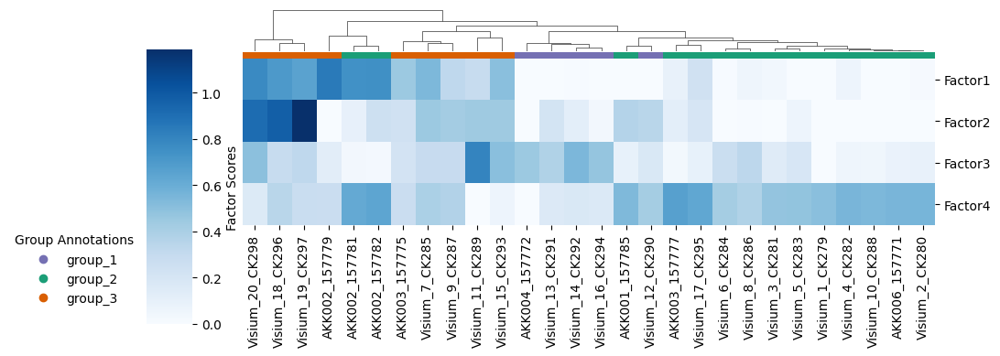

In [474]:
chart = sns.clustermap(nmfbulk.X.T, cmap='Blues', 
                       cbar_kws={'label': 'Factor Scores', 'orientation':'vertical'},
               row_cluster=False, col_cluster=True,
               col_colors=[group_cmap[x] for x in group_annotations],
               # change size
               figsize=(10, 4),
               # remove dendogram
                # add x axis label
                xticklabels=nmfbulk.obs.index,
                yticklabels=nmfbulk.var.index,
                cbar_pos=(0.1, 0.1, 0.05, 0.75)
               )
# rotate labels
chart.ax_heatmap.set_yticklabels(chart.ax_heatmap.get_ymajorticklabels(), rotation=0)
colorbar = chart.ax_col_colors.collections[0].colorbar

# Create custom legend
legend_handles = []
for label, color in zip(set(group_annotations), set(group_cmap.values())):
    legend_handles.append(plt.Line2D([0], [0], color=color, marker='o', linestyle='', label=label))

# Add legend
legend = plt.legend(handles=legend_handles, title='Group Annotations', loc='upper right', frameon=False)

# Move the legend
chart_size = chart.ax_heatmap.get_position()
plt.setp(legend.get_title(), fontsize='medium')  # Set the font size of the legend title
legend.set_bbox_to_anchor((chart_size.x1 - 1, chart_size.y0))  # Adjust the position of the legend
plt.show()